<a href="https://colab.research.google.com/github/Kim-matthew-0422/GAN-style/blob/main/Gan-main.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!nvidia-smi -L

GPU 0: Tesla T4 (UUID: GPU-bfd99a56-cc89-c128-a344-f8a2c0803d98)


In [ ]:

from google.colab import files

In [ ]:
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"etkim422","key":"b91c86a0e76a000e4ddfd6ab1ceaf138"}'}

In [ ]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/

In [ ]:
!kaggle datasets download -d ikarus777/best-artworks-of-all-time


100% 2.29G/2.29G [02:09<00:00, 20.8MB/s]
100% 2.29G/2.29G [02:09<00:00, 18.9MB/s]


In [ ]:
!unzip best-artworks-of-all-time.zip

Streaming output truncated to the last 5000 lines.
  inflating: resized/resized/Henri_Rousseau_61.jpg  
  inflating: resized/resized/Henri_Rousseau_62.jpg  
  inflating: resized/resized/Henri_Rousseau_63.jpg  
  inflating: resized/resized/Henri_Rousseau_64.jpg  
  inflating: resized/resized/Henri_Rousseau_65.jpg  
  inflating: resized/resized/Henri_Rousseau_66.jpg  
  inflating: resized/resized/Henri_Rousseau_67.jpg  
  inflating: resized/resized/Henri_Rousseau_68.jpg  
  inflating: resized/resized/Henri_Rousseau_69.jpg  
  inflating: resized/resized/Henri_Rousseau_7.jpg  
  inflating: resized/resized/Henri_Rousseau_70.jpg  
  inflating: resized/resized/Henri_Rousseau_8.jpg  
  inflating: resized/resized/Henri_Rousseau_9.jpg  
  inflating: resized/resized/Henri_de_Toulouse-Lautrec_1.jpg  
  inflating: resized/resized/Henri_de_Toulouse-Lautrec_10.jpg  
  inflating: resized/resized/Henri_de_Toulouse-Lautrec_11.jpg  
  inflating: resized/resized/Henri_de_Toulouse-Lautrec_12.jpg  
  inflat

Sample arts


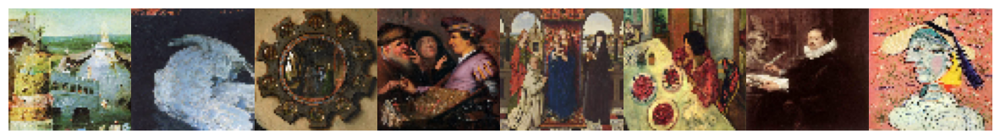

In [ ]:
import os
from glob import glob

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pandas as pd
import cv2 as cv

data_dir = ''
image_dir = 'resized/resized'
image_root = 'resized'
no_plots = 8*1
images = glob(f'{image_dir}/*')

plt.rcParams['figure.figsize'] = (15, 15)
plt.subplots_adjust(wspace=0, hspace=0)

print("Sample arts")
for idx,image in enumerate(images[:no_plots]):
    sample_img = cv.imread(image)
    sample_img = cv.resize(sample_img,(64,64))
    plt.subplot(1, 8, idx+1)
    plt.axis('off')
    plt.imshow(cv.cvtColor(sample_img,cv.COLOR_BGR2RGB))
plt.show()

Found 8683 files belonging to 1 classes.


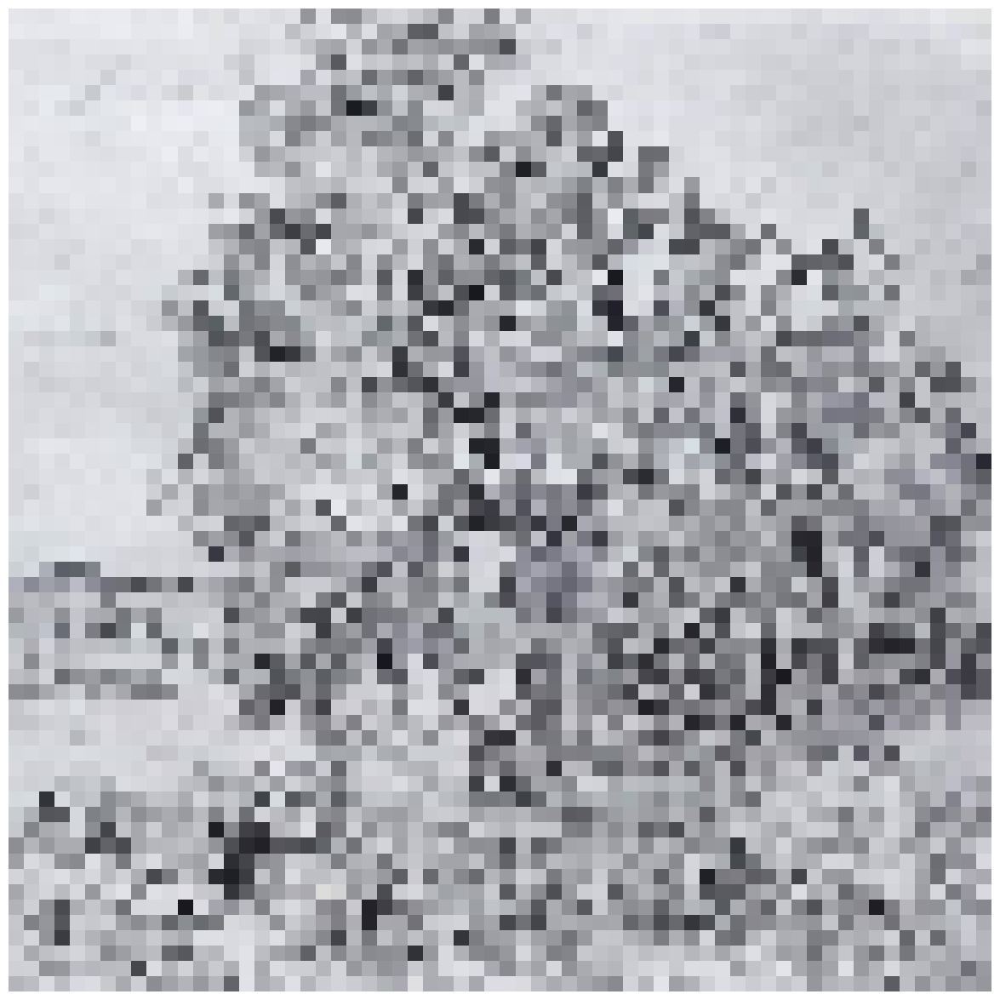

In [ ]:
import tensorflow as tf
import matplotlib.pyplot as plt

def get_dataloader_tf(batch_size, image_size, data_dir):
    def preprocess_image(image, label):
        image = tf.image.resize(image, [image_size, image_size])
        image = tf.cast(image, tf.float32)
        image = (image - 127.5) / 127.5
        return image, label

    data = tf.keras.preprocessing.image_dataset_from_directory(
        data_dir,
        label_mode='int',
        image_size=(image_size, image_size),
        batch_size=batch_size
    )

    data = data.map(preprocess_image).prefetch(tf.data.experimental.AUTOTUNE)

    return data

def tensor_imshow(image):
    plt.imshow((image.numpy() * 127.5 + 127.5).astype("uint8"))
    plt.axis("off")
    plt.show()

# Testing the dataloader
image_root = 'resized'

batch_size, image_size = 5, 64
train_loader = get_dataloader_tf(batch_size, image_size, image_root)
dataiter = iter(train_loader)

img, _ = next(dataiter)
sample_img = img[-1]
tensor_imshow(sample_img)


In [ ]:
import tensorflow as tf
from tensorflow.keras import layers

class Generator(tf.keras.Model):
    def __init__(self, z_dim=10, in_chan=3, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        self.in_chan = in_chan
        self.hidden_dim = hidden_dim

        self.generator = tf.keras.Sequential([
            tf.keras.layers.Dense(4*4*512, use_bias=False, input_shape=(z_dim,)),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),

            tf.keras.layers.Reshape((4, 4, 512)),

            tf.keras.layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),

            tf.keras.layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
            
            tf.keras.layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
            
            tf.keras.layers.Conv2DTranspose(32, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),

            tf.keras.layers.Conv2DTranspose(in_chan, (4, 4), strides=(2, 2), padding='same', use_bias=False, activation='tanh')
        ])

    def make_gen_block(self, in_channels, op_channels, kernel_size=4, stride=2, padding=1, final_layer=False):
        layers = []
        layers.append(tf.keras.layers.Conv2DTranspose(op_channels, kernel_size, strides=stride, padding=padding, use_bias=False))
        

        if not final_layer:
            layers.append(tf.keras.layers.BatchNormalization())
            layers.append(tf.keras.layers.LeakyReLU(0.2))
        else:
            layers.append(tf.keras.layers.Activation('tanh'))

        return tf.keras.Sequential(layers)

    def call(self, noise):
        x = tf.reshape(noise, [-1, self.z_dim])
        return self.generator(x)

    def get_noise(self, n_samples, z_dim):
        return tf.random.normal([n_samples, z_dim])


class Discriminator(tf.keras.Model):
    def __init__(self, im_chan=3, conv_dim=64, image_size=64):
        super(Discriminator, self).__init__()
        self.image_size = image_size
        self.conv_dim = conv_dim

        self.disc_cnn = tf.keras.Sequential([
            self.make_disc_block(3, 32),
            self.make_disc_block(32, 64),
            self.make_disc_block(64, 128),
            self.make_disc_block(128, 256),
            self.make_disc_block(256, 512),
            self.make_disc_block(512, 1, padding=0, final_layer=True),
        ])

    def make_disc_block(self, in_chan, op_chan, kernel_size=4, stride=2, padding=1, final_layer=False):
        layers = [
            tf.keras.layers.Conv2D(op_chan, kernel_size, strides=stride, padding='same', use_bias=False)
        ]

        if not final_layer:
            layers.append(tf.keras.layers.BatchNormalization())
            layers.append(tf.keras.layers.LeakyReLU(0.2))
        else:
            # Add a GlobalAveragePooling2D layer before the final layer to ensure output shape is (batch_size, 1)
            layers.append(tf.keras.layers.GlobalAveragePooling2D())

        return tf.keras.Sequential(layers)

    def call(self, image):
        pred = self.disc_cnn(image)
        return pred



In [ ]:
def weights_init_normal(layer):
    if isinstance(layer, tf.keras.layers.Conv2D) or isinstance(layer, tf.keras.layers.Conv2DTranspose):
        layer.set_weights([tf.random.normal(layer.get_weights()[0].shape, mean=0.0, stddev=0.02)])
    if isinstance(layer, tf.keras.layers.BatchNormalization):
        layer.set_weights([
            tf.random.normal(layer.get_weights()[0].shape, mean=0.0, stddev=0.02),
            tf.zeros_like(layer.get_weights()[1])
        ])

def apply_weight_init(model):
    for layer in model.layers:
        weights_init_normal(layer)



In [ ]:
def real_loss(D_out, device='cpu'):
    criterion = tf.keras.losses.BinaryCrossentropy(from_logits=True)
    batch_size = D_out.shape[0]
    labels = tf.ones((batch_size, 1), dtype=tf.float32) * 0.9  # real labels = 1 and label smoothing => 0.9

    loss = criterion(labels, D_out)
    return loss

def fake_loss(D_out, device='cpu'):
    criterion = tf.keras.losses.BinaryCrossentropy(from_logits=True)
    batch_size = D_out.shape[0]
    labels = tf.zeros((batch_size, 1), dtype=tf.float32)  # fake labels = 0

    loss = criterion(labels, D_out)
    return loss


In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def print_tensor_images(images_tensor):
    plt.rcParams['figure.figsize'] = (15, 15)
    plt.subplots_adjust(wspace=0, hspace=0)
    
    npimgs = images_tensor.numpy()
    
    no_plots = len(npimgs)

    for idx, image in enumerate(npimgs):
        plt.subplot(1, 8, idx+1)
        plt.axis('off')
        # dnorm
        image = image * 0.5 + 0.5
        plt.imshow(image)  # Removed np.transpose
    plt.show()

def train(D, G, n_epochs, dataloader, d_optimizer, g_optimizer, z_dim, print_every=50):
    
    ## Get some fixed data for sampling.##      
    sample_size = 8
    fixed_z = get_noise(n_samples=sample_size, z_dim=z_dim)
    
    for epoch in range(1, n_epochs+1):
        for batch_i, (real_images, _) in enumerate(dataloader):
            batch_size = real_images.shape[0]
            
            ### Discriminator part ###
            with tf.GradientTape() as tape:
                # Loss on real image
                d_real_op = D(real_images)
                d_real_loss = real_loss(d_real_op)
                
                # Loss on fake image
                noise = get_noise(n_samples=batch_size, z_dim=z_dim)
                fake_images = G(noise)
                d_fake_op = D(fake_images)
                d_fake_loss = fake_loss(d_fake_op)
                
                # Total loss
                d_loss = d_real_loss + d_fake_loss

            gradients = tape.gradient(d_loss, D.trainable_variables)
            d_optimizer.apply_gradients(zip(gradients, D.trainable_variables))
            
            ### Generator part ###
            with tf.GradientTape() as tape:
                noise = get_noise(n_samples=batch_size, z_dim=z_dim)
                g_out = G(noise)
                d_out = D(g_out)
                
                g_loss = real_loss(d_out)

            gradients = tape.gradient(g_loss, G.trainable_variables)
            g_optimizer.apply_gradients(zip(gradients, G.trainable_variables))
        
        
        print('Epoch [{:5d}/{:5d}] | d_loss: {:6.4f} | g_loss: {:6.4f}'.format(
                                epoch, n_epochs, d_loss.numpy(), g_loss.numpy()))
        if (epoch % print_every == 0):
            G.trainable = False
            sample_image = G(fixed_z)
            print_tensor_images(sample_image)
            G.trainable = True


In [ ]:
import tensorflow as tf

# Hyperparameters
device = "GPU" if tf.config.list_physical_devices('GPU') else "CPU"
print("Device is", device)

z_dim = 150
beta_1 = 0.5
beta_2 = 0.999

n_epochs = 150
lr = 0.0002
lr_g = 0.0004
batch_size = 128
image_size = 128


Device is GPU


In [ ]:
# Model initialization
gen = Generator(z_dim, in_chan=3, hidden_dim=64)
disc = Discriminator(im_chan=3, conv_dim=64, image_size=image_size)

# Optimizer initialization
g_optimizer = tf.keras.optimizers.Adam(learning_rate=lr_g, beta_1=beta_1, beta_2=beta_2)
d_optimizer = tf.keras.optimizers.Adam(learning_rate=lr, beta_1=beta_1, beta_2=beta_2)

dataloader = get_dataloader_tf(batch_size, image_size, image_root)


Found 8683 files belonging to 1 classes.


In [ ]:
def get_noise(n_samples, z_dim, seed=None):
    if seed is not None:
        tf.random.set_seed(seed)
    return tf.random.normal([n_samples, z_dim])


Epoch [    1/  100] | d_loss: 1.0166 | g_loss: 1.7022
Epoch [    2/  100] | d_loss: 0.4626 | g_loss: 5.0789
Epoch [    3/  100] | d_loss: 0.7410 | g_loss: 2.4242
Epoch [    4/  100] | d_loss: 1.1799 | g_loss: 0.8067
Epoch [    5/  100] | d_loss: 1.0413 | g_loss: 1.5961
Epoch [    6/  100] | d_loss: 0.9493 | g_loss: 1.7358
Epoch [    7/  100] | d_loss: 0.9800 | g_loss: 1.6754
Epoch [    8/  100] | d_loss: 1.0981 | g_loss: 2.0555
Epoch [    9/  100] | d_loss: 0.9753 | g_loss: 1.7073
Epoch [   10/  100] | d_loss: 1.1354 | g_loss: 1.2565


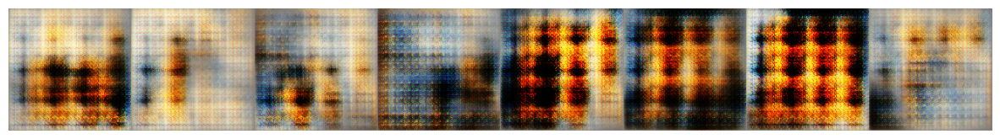

Epoch [   11/  100] | d_loss: 1.0768 | g_loss: 1.5301
Epoch [   12/  100] | d_loss: 1.1844 | g_loss: 1.2382
Epoch [   13/  100] | d_loss: 1.3080 | g_loss: 1.1070
Epoch [   14/  100] | d_loss: 1.3116 | g_loss: 1.2152
Epoch [   15/  100] | d_loss: 1.2504 | g_loss: 0.9847
Epoch [   16/  100] | d_loss: 1.1616 | g_loss: 1.5100
Epoch [   17/  100] | d_loss: 1.1586 | g_loss: 1.3878
Epoch [   18/  100] | d_loss: 1.3393 | g_loss: 1.0369
Epoch [   19/  100] | d_loss: 1.2278 | g_loss: 1.3372
Epoch [   20/  100] | d_loss: 1.2799 | g_loss: 1.4415


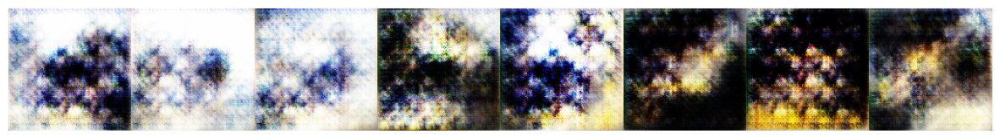

Epoch [   21/  100] | d_loss: 1.1678 | g_loss: 1.2792
Epoch [   22/  100] | d_loss: 1.0709 | g_loss: 1.8110
Epoch [   23/  100] | d_loss: 0.9703 | g_loss: 1.7984
Epoch [   24/  100] | d_loss: 1.2794 | g_loss: 1.3501
Epoch [   25/  100] | d_loss: 1.2676 | g_loss: 1.0999
Epoch [   26/  100] | d_loss: 1.1611 | g_loss: 1.8341
Epoch [   27/  100] | d_loss: 1.2365 | g_loss: 1.4148
Epoch [   28/  100] | d_loss: 1.2244 | g_loss: 1.5039
Epoch [   29/  100] | d_loss: 1.1652 | g_loss: 1.4743
Epoch [   30/  100] | d_loss: 1.3165 | g_loss: 1.3653


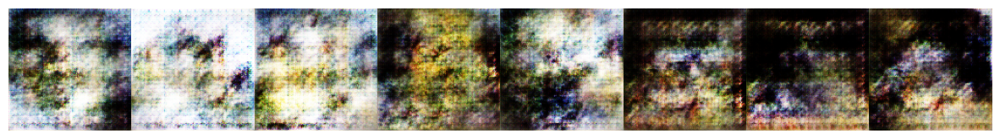

Epoch [   31/  100] | d_loss: 1.3889 | g_loss: 1.0804
Epoch [   32/  100] | d_loss: 1.4912 | g_loss: 0.8321
Epoch [   33/  100] | d_loss: 1.2613 | g_loss: 1.1030
Epoch [   34/  100] | d_loss: 1.2250 | g_loss: 1.3101
Epoch [   35/  100] | d_loss: 1.3352 | g_loss: 1.1126
Epoch [   36/  100] | d_loss: 1.2425 | g_loss: 1.1402
Epoch [   37/  100] | d_loss: 1.3087 | g_loss: 1.4035
Epoch [   38/  100] | d_loss: 1.2404 | g_loss: 1.5208
Epoch [   39/  100] | d_loss: 1.3052 | g_loss: 1.0887
Epoch [   40/  100] | d_loss: 1.4361 | g_loss: 0.9950


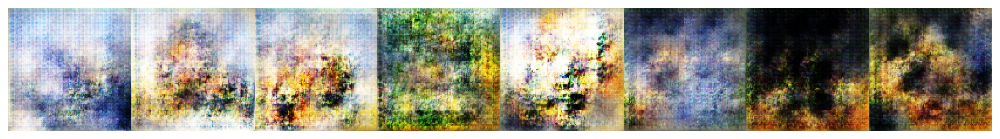

Epoch [   41/  100] | d_loss: 1.2129 | g_loss: 1.4509
Epoch [   42/  100] | d_loss: 1.3321 | g_loss: 1.1605
Epoch [   43/  100] | d_loss: 1.2654 | g_loss: 1.0533
Epoch [   44/  100] | d_loss: 1.3038 | g_loss: 1.1515
Epoch [   45/  100] | d_loss: 1.2694 | g_loss: 1.4335
Epoch [   46/  100] | d_loss: 1.1024 | g_loss: 1.3049
Epoch [   47/  100] | d_loss: 1.0582 | g_loss: 1.4230
Epoch [   48/  100] | d_loss: 1.1855 | g_loss: 1.5957
Epoch [   49/  100] | d_loss: 1.1164 | g_loss: 1.5487
Epoch [   50/  100] | d_loss: 1.1889 | g_loss: 1.4257


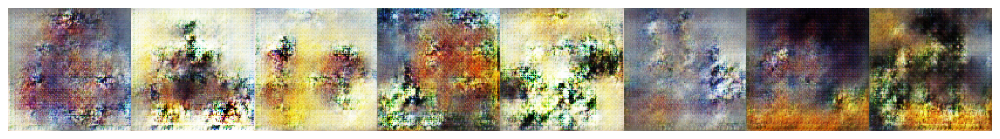

Epoch [   51/  100] | d_loss: 1.2401 | g_loss: 1.2586
Epoch [   52/  100] | d_loss: 1.2475 | g_loss: 1.3915
Epoch [   53/  100] | d_loss: 1.0752 | g_loss: 1.4608
Epoch [   54/  100] | d_loss: 1.2041 | g_loss: 1.4705
Epoch [   55/  100] | d_loss: 1.0315 | g_loss: 1.4278
Epoch [   56/  100] | d_loss: 1.2641 | g_loss: 1.4098
Epoch [   57/  100] | d_loss: 1.1199 | g_loss: 1.3913
Epoch [   58/  100] | d_loss: 0.9031 | g_loss: 1.7106
Epoch [   59/  100] | d_loss: 1.1026 | g_loss: 1.4168
Epoch [   60/  100] | d_loss: 1.2408 | g_loss: 1.5152


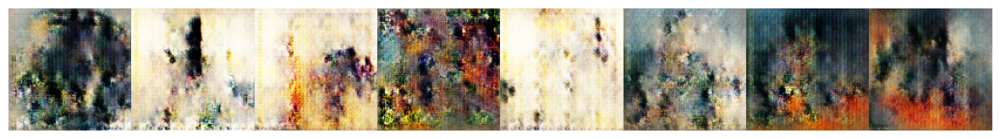

Epoch [   61/  100] | d_loss: 1.0122 | g_loss: 1.6837
Epoch [   62/  100] | d_loss: 1.0785 | g_loss: 1.5005
Epoch [   63/  100] | d_loss: 0.9061 | g_loss: 1.6687
Epoch [   64/  100] | d_loss: 1.0860 | g_loss: 1.5728
Epoch [   65/  100] | d_loss: 0.9497 | g_loss: 1.8235
Epoch [   66/  100] | d_loss: 1.2829 | g_loss: 1.3313
Epoch [   67/  100] | d_loss: 0.9757 | g_loss: 1.6277
Epoch [   68/  100] | d_loss: 0.9103 | g_loss: 1.5272
Epoch [   69/  100] | d_loss: 1.0504 | g_loss: 1.4269
Epoch [   70/  100] | d_loss: 0.9288 | g_loss: 1.9739


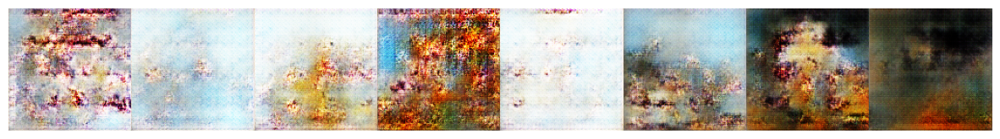

Epoch [   71/  100] | d_loss: 1.3537 | g_loss: 1.5086
Epoch [   72/  100] | d_loss: 1.0883 | g_loss: 1.5766
Epoch [   73/  100] | d_loss: 1.0256 | g_loss: 1.7611
Epoch [   74/  100] | d_loss: 1.0476 | g_loss: 1.4723
Epoch [   75/  100] | d_loss: 0.9135 | g_loss: 2.0742
Epoch [   76/  100] | d_loss: 1.1272 | g_loss: 1.7763
Epoch [   77/  100] | d_loss: 1.1409 | g_loss: 1.4429
Epoch [   78/  100] | d_loss: 0.9329 | g_loss: 1.6922
Epoch [   79/  100] | d_loss: 0.9375 | g_loss: 1.6951
Epoch [   80/  100] | d_loss: 1.1214 | g_loss: 1.3211


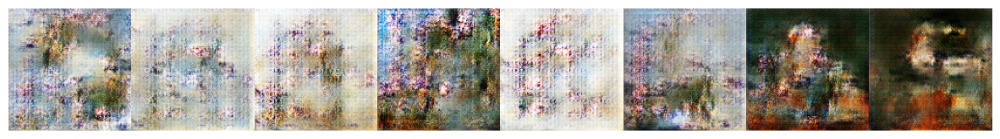

Epoch [   81/  100] | d_loss: 1.0910 | g_loss: 1.3124
Epoch [   82/  100] | d_loss: 0.9936 | g_loss: 1.6837
Epoch [   83/  100] | d_loss: 0.9932 | g_loss: 1.7289
Epoch [   84/  100] | d_loss: 1.1536 | g_loss: 1.7262
Epoch [   85/  100] | d_loss: 1.1012 | g_loss: 1.5703
Epoch [   86/  100] | d_loss: 1.1408 | g_loss: 1.4832
Epoch [   87/  100] | d_loss: 1.1036 | g_loss: 1.4808
Epoch [   88/  100] | d_loss: 1.1239 | g_loss: 1.6936
Epoch [   89/  100] | d_loss: 1.1029 | g_loss: 1.3512
Epoch [   90/  100] | d_loss: 1.0722 | g_loss: 1.4382


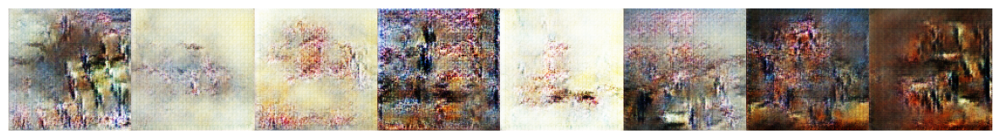

Epoch [   91/  100] | d_loss: 1.0343 | g_loss: 1.5323
Epoch [   92/  100] | d_loss: 1.0694 | g_loss: 1.4505
Epoch [   93/  100] | d_loss: 0.9217 | g_loss: 1.1929
Epoch [   94/  100] | d_loss: 1.1434 | g_loss: 1.8400
Epoch [   95/  100] | d_loss: 0.9683 | g_loss: 1.6772
Epoch [   96/  100] | d_loss: 0.9775 | g_loss: 1.8088
Epoch [   97/  100] | d_loss: 1.1431 | g_loss: 1.4389
Epoch [   98/  100] | d_loss: 0.9353 | g_loss: 1.8796
Epoch [   99/  100] | d_loss: 1.0067 | g_loss: 1.7113
Epoch [  100/  100] | d_loss: 1.0353 | g_loss: 1.3939


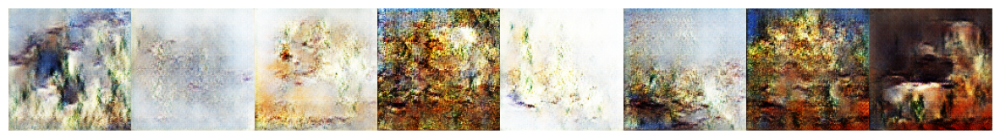

In [ ]:
n_epochs = 100
train(
    disc, gen,
    n_epochs, dataloader,
    d_optimizer, g_optimizer,
    z_dim,
    print_every=10,
)


I think increasing the learning rate of the generator would be beneficial for a better tuning.

In [ ]:
!pip install tensorflow-addons

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 591.0/591.0 kB 42.0 MB/s eta 0:00:00


In [ ]:
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow_addons.layers import SpectralNormalization


In [ ]:
import tensorflow_addons as tfa

/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


In [ ]:
import tensorflow as tf
from tensorflow.keras import layers

class Generator(tf.keras.Model):
    def __init__(self, z_dim=10, in_chan=3, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        self.in_chan = in_chan
        self.hidden_dim = hidden_dim

        self.generator = tf.keras.Sequential([
            tf.keras.layers.Dense(4*4*512, use_bias=False, input_shape=(z_dim,)),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),

            tf.keras.layers.Reshape((4, 4, 512)),

            tf.keras.layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),

            tf.keras.layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
            
            tf.keras.layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
            
            tf.keras.layers.Conv2DTranspose(32, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),

            tf.keras.layers.Conv2DTranspose(in_chan, (4, 4), strides=(2, 2), padding='same', use_bias=False, activation='tanh')
        ])

    def make_gen_block(self, in_channels, op_channels, kernel_size=4, stride=2, padding=1, final_layer=False):
        layers = []
        layers.append(tf.keras.layers.Conv2DTranspose(op_channels, kernel_size, strides=stride, padding=padding, use_bias=False))
        

        if not final_layer:
            layers.append(tf.keras.layers.BatchNormalization())
            layers.append(tf.keras.layers.LeakyReLU(0.2))
        else:
            layers.append(tf.keras.layers.Activation('tanh'))

        return tf.keras.Sequential(layers)

    def call(self, noise):
        x = tf.reshape(noise, [-1, self.z_dim])
        return self.generator(x)

    def get_noise(self, n_samples, z_dim):
        return tf.random.normal([n_samples, z_dim])


class Discriminator(tf.keras.Model):
    def __init__(self, im_chan=3, conv_dim=64, image_size=64):
        super(Discriminator, self).__init__()
        self.image_size = image_size
        self.conv_dim = conv_dim

        self.disc_cnn = tf.keras.Sequential([
            self.make_disc_block(3, 32),
            self.make_disc_block(32, 64),
            self.make_disc_block(64, 128),
            self.make_disc_block(128, 256),
            self.make_disc_block(256, 512),
            self.make_disc_block(512, 1, padding=0, final_layer=True),
        ])

    def make_disc_block(self, in_chan, op_chan, kernel_size=4, stride=2, padding=1, final_layer=False):
        layers_list = [
            tfa.layers.SpectralNormalization(
                tf.keras.layers.Conv2D(op_chan, kernel_size, strides=stride, padding='same', use_bias=False)
            )
        ]

        if not final_layer:
            layers_list.append(tf.keras.layers.BatchNormalization())
            layers_list.append(tf.keras.layers.LeakyReLU(0.2))
            layers_list.append(tf.keras.layers.Dropout(0.3))
        else:
            # Add a GlobalAveragePooling2D layer before the final layer to ensure output shape is (batch_size, 1)
            layers_list.append(tf.keras.layers.GlobalAveragePooling2D())

        return tf.keras.Sequential(layers_list)

    def call(self, image):
        pred = self.disc_cnn(image)
        return pred



spectral normalization, filtersize change, and dropout layers.

In [ ]:
import tensorflow as tf

# Hyperparameters
device = "GPU" if tf.config.list_physical_devices('GPU') else "CPU"
print("Device is", device)

z_dim = 150
beta_1 = 0.5
beta_2 = 0.999

n_epochs = 150
lr = 0.0002
lr_g = 0.0004
batch_size = 128
image_size = 128


Device is GPU


In [ ]:
# Model initialization
gen = Generator(z_dim, in_chan=3, hidden_dim=64)
disc = Discriminator(im_chan=3, conv_dim=64, image_size=image_size)

# Optimizer initialization
g_optimizer = tf.keras.optimizers.Adam(learning_rate=lr_g, beta_1=beta_1, beta_2=beta_2)
d_optimizer = tf.keras.optimizers.Adam(learning_rate=lr, beta_1=beta_1, beta_2=beta_2)

dataloader = get_dataloader_tf(batch_size, image_size, image_root)


Found 8683 files belonging to 1 classes.


Epoch [    1/  100] | d_loss: 0.9083 | g_loss: 4.0496
Epoch [    2/  100] | d_loss: 0.9535 | g_loss: 1.5606
Epoch [    3/  100] | d_loss: 0.8032 | g_loss: 2.6196
Epoch [    4/  100] | d_loss: 1.3391 | g_loss: 0.9324
Epoch [    5/  100] | d_loss: 1.0162 | g_loss: 1.3034
Epoch [    6/  100] | d_loss: 0.9775 | g_loss: 1.4503
Epoch [    7/  100] | d_loss: 1.2082 | g_loss: 1.5343
Epoch [    8/  100] | d_loss: 1.3840 | g_loss: 1.5172
Epoch [    9/  100] | d_loss: 1.1065 | g_loss: 1.3303
Epoch [   10/  100] | d_loss: 1.1509 | g_loss: 1.7142


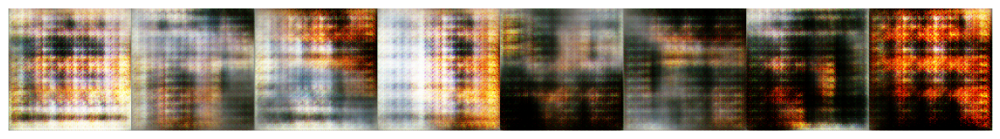

Epoch [   11/  100] | d_loss: 1.3053 | g_loss: 1.8092
Epoch [   12/  100] | d_loss: 1.3427 | g_loss: 0.8262
Epoch [   13/  100] | d_loss: 1.1738 | g_loss: 1.1041
Epoch [   14/  100] | d_loss: 1.0966 | g_loss: 1.3220
Epoch [   15/  100] | d_loss: 1.0960 | g_loss: 2.3336
Epoch [   16/  100] | d_loss: 1.3425 | g_loss: 1.1103
Epoch [   17/  100] | d_loss: 1.3650 | g_loss: 1.2491
Epoch [   18/  100] | d_loss: 1.0914 | g_loss: 1.5664
Epoch [   19/  100] | d_loss: 1.1885 | g_loss: 1.1694
Epoch [   20/  100] | d_loss: 1.2230 | g_loss: 1.3983


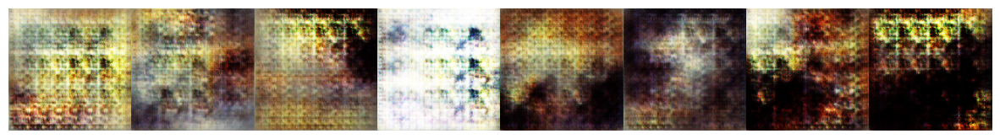

Epoch [   21/  100] | d_loss: 1.2279 | g_loss: 1.2204
Epoch [   22/  100] | d_loss: 1.3421 | g_loss: 1.1543
Epoch [   23/  100] | d_loss: 1.1950 | g_loss: 1.1282
Epoch [   24/  100] | d_loss: 1.1057 | g_loss: 1.4225
Epoch [   25/  100] | d_loss: 1.2179 | g_loss: 1.6197
Epoch [   26/  100] | d_loss: 1.3314 | g_loss: 1.1084
Epoch [   27/  100] | d_loss: 1.2066 | g_loss: 1.4177
Epoch [   28/  100] | d_loss: 1.2884 | g_loss: 1.1276
Epoch [   29/  100] | d_loss: 1.1682 | g_loss: 1.2672
Epoch [   30/  100] | d_loss: 1.1888 | g_loss: 1.1372


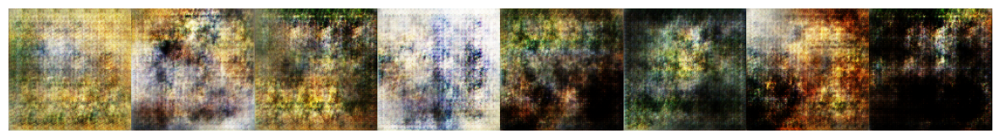

Epoch [   31/  100] | d_loss: 1.2177 | g_loss: 1.3884
Epoch [   32/  100] | d_loss: 1.3849 | g_loss: 1.7646
Epoch [   33/  100] | d_loss: 1.3609 | g_loss: 1.3848
Epoch [   34/  100] | d_loss: 1.1620 | g_loss: 1.2924
Epoch [   35/  100] | d_loss: 1.1736 | g_loss: 1.1509
Epoch [   36/  100] | d_loss: 1.1497 | g_loss: 1.4319
Epoch [   37/  100] | d_loss: 1.1890 | g_loss: 1.2561
Epoch [   38/  100] | d_loss: 1.2967 | g_loss: 1.1459
Epoch [   39/  100] | d_loss: 1.2290 | g_loss: 1.0525
Epoch [   40/  100] | d_loss: 1.3239 | g_loss: 1.5432


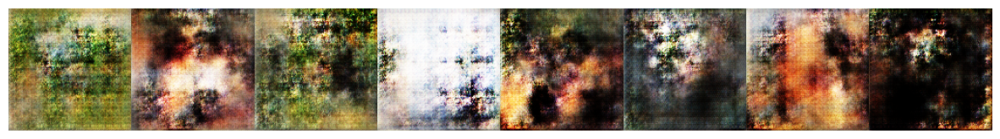

Epoch [   41/  100] | d_loss: 1.1963 | g_loss: 1.2311
Epoch [   42/  100] | d_loss: 1.3417 | g_loss: 1.1287
Epoch [   43/  100] | d_loss: 1.0197 | g_loss: 1.4458
Epoch [   44/  100] | d_loss: 1.3484 | g_loss: 1.5388
Epoch [   45/  100] | d_loss: 1.0591 | g_loss: 1.2636
Epoch [   46/  100] | d_loss: 1.1539 | g_loss: 1.6068
Epoch [   47/  100] | d_loss: 1.0840 | g_loss: 1.2793
Epoch [   48/  100] | d_loss: 1.2341 | g_loss: 1.3470
Epoch [   49/  100] | d_loss: 1.2234 | g_loss: 1.8238
Epoch [   50/  100] | d_loss: 1.3360 | g_loss: 1.4830


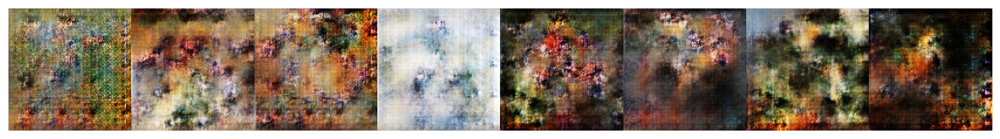

Epoch [   51/  100] | d_loss: 1.3148 | g_loss: 1.5399
Epoch [   52/  100] | d_loss: 1.0651 | g_loss: 1.4804
Epoch [   53/  100] | d_loss: 1.1964 | g_loss: 1.5391
Epoch [   54/  100] | d_loss: 1.0406 | g_loss: 1.3265
Epoch [   55/  100] | d_loss: 1.1057 | g_loss: 1.3468
Epoch [   56/  100] | d_loss: 1.1746 | g_loss: 1.5500
Epoch [   57/  100] | d_loss: 1.0151 | g_loss: 1.4591
Epoch [   58/  100] | d_loss: 0.9536 | g_loss: 1.3046
Epoch [   59/  100] | d_loss: 1.1780 | g_loss: 1.5916
Epoch [   60/  100] | d_loss: 1.3219 | g_loss: 1.2633


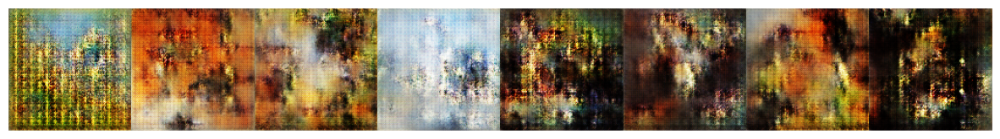

Epoch [   61/  100] | d_loss: 0.9975 | g_loss: 1.6909
Epoch [   62/  100] | d_loss: 0.9840 | g_loss: 1.3856
Epoch [   63/  100] | d_loss: 1.0514 | g_loss: 1.5727
Epoch [   64/  100] | d_loss: 1.1844 | g_loss: 1.4893
Epoch [   65/  100] | d_loss: 1.0604 | g_loss: 1.4331
Epoch [   66/  100] | d_loss: 1.2005 | g_loss: 1.7420
Epoch [   67/  100] | d_loss: 1.1074 | g_loss: 1.3088
Epoch [   68/  100] | d_loss: 1.1892 | g_loss: 1.7384
Epoch [   69/  100] | d_loss: 0.9942 | g_loss: 1.4847
Epoch [   70/  100] | d_loss: 1.0054 | g_loss: 1.6360


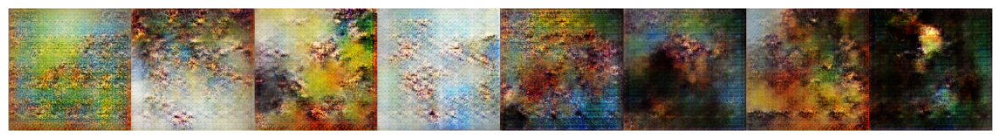

Epoch [   71/  100] | d_loss: 0.9912 | g_loss: 1.7757
Epoch [   72/  100] | d_loss: 0.9155 | g_loss: 2.4315
Epoch [   73/  100] | d_loss: 1.3705 | g_loss: 1.6950
Epoch [   74/  100] | d_loss: 0.7954 | g_loss: 1.8961
Epoch [   75/  100] | d_loss: 1.1530 | g_loss: 1.6639
Epoch [   76/  100] | d_loss: 0.9889 | g_loss: 2.5631
Epoch [   77/  100] | d_loss: 1.0177 | g_loss: 2.9841
Epoch [   78/  100] | d_loss: 0.9996 | g_loss: 2.2431
Epoch [   79/  100] | d_loss: 0.7991 | g_loss: 2.0100
Epoch [   80/  100] | d_loss: 1.0623 | g_loss: 1.9200


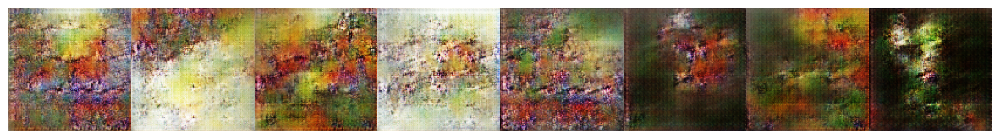

Epoch [   81/  100] | d_loss: 1.1626 | g_loss: 1.7391
Epoch [   82/  100] | d_loss: 0.9298 | g_loss: 2.0623
Epoch [   83/  100] | d_loss: 0.8639 | g_loss: 2.4309
Epoch [   84/  100] | d_loss: 0.8664 | g_loss: 2.0513
Epoch [   85/  100] | d_loss: 0.9073 | g_loss: 2.0356
Epoch [   86/  100] | d_loss: 1.0956 | g_loss: 1.9639
Epoch [   87/  100] | d_loss: 0.9634 | g_loss: 2.3318
Epoch [   88/  100] | d_loss: 0.9729 | g_loss: 1.9842
Epoch [   89/  100] | d_loss: 0.9928 | g_loss: 2.0818
Epoch [   90/  100] | d_loss: 1.1203 | g_loss: 2.4335


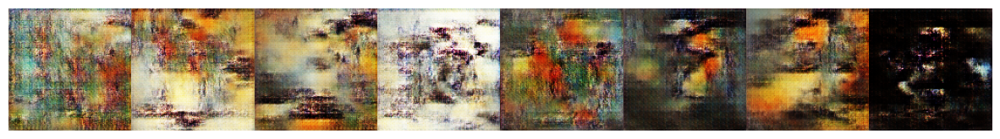

Epoch [   91/  100] | d_loss: 0.8264 | g_loss: 1.9440
Epoch [   92/  100] | d_loss: 1.0118 | g_loss: 1.8825
Epoch [   93/  100] | d_loss: 0.8699 | g_loss: 2.1306
Epoch [   94/  100] | d_loss: 0.9486 | g_loss: 2.2975
Epoch [   95/  100] | d_loss: 0.9603 | g_loss: 1.8370
Epoch [   96/  100] | d_loss: 0.9742 | g_loss: 2.4127
Epoch [   97/  100] | d_loss: 0.7597 | g_loss: 2.1759
Epoch [   98/  100] | d_loss: 0.7725 | g_loss: 2.0331
Epoch [   99/  100] | d_loss: 1.0102 | g_loss: 1.8703
Epoch [  100/  100] | d_loss: 0.9138 | g_loss: 1.9130


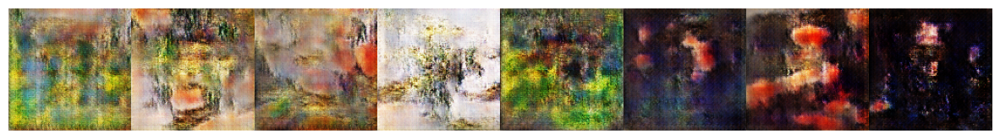

In [ ]:
n_epochs = 100
train(
    disc, gen,
    n_epochs, dataloader,
    d_optimizer, g_optimizer,
    z_dim,
    print_every=10,
)


WGAN with gradient penalty

In [ ]:
import tensorflow as tf

In [ ]:
def wasserstein_loss(y_true, y_pred):
    return tf.reduce_mean(y_true * y_pred)


In [ ]:
def real_loss(D_out):
    return wasserstein_loss(tf.ones_like(D_out), D_out)

def fake_loss(D_out):
    return wasserstein_loss(-tf.ones_like(D_out), D_out)


In [ ]:
def gradient_penalty(real_images, fake_images, discriminator):
    batch_size = real_images.shape[0]
    epsilon = tf.random.uniform([batch_size, 1, 1, 1], 0.0, 1.0)
    interpolated_images = epsilon * real_images + (1 - epsilon) * fake_images
    with tf.GradientTape() as tape:
        tape.watch(interpolated_images)
        pred = discriminator(interpolated_images)

    gradients = tape.gradient(pred, interpolated_images)
    gradients_norm = tf.sqrt(tf.reduce_sum(tf.square(gradients), axis=[1, 2, 3]))
    penalty = tf.reduce_mean((gradients_norm - 1.0) ** 2)
    return penalty


In [ ]:
def real_loss(real_output):
    return -tf.reduce_mean(real_output)

def fake_loss(fake_output):
    return tf.reduce_mean(fake_output)

def gradient_penalty(real_images, fake_images, discriminator):
    batch_size = real_images.shape[0]
    t = tf.random.uniform(shape=(batch_size, 1, 1, 1))
    x_hat = t * real_images + (1 - t) * fake_images
    with tf.GradientTape() as tape:
        tape.watch(x_hat)
        d_x_hat = discriminator(x_hat)
    gradients = tape.gradient(d_x_hat, x_hat)
    gradient_norms = tf.sqrt(tf.reduce_sum(tf.square(gradients), axis=[1, 2, 3]))
    return tf.reduce_mean((gradient_norms - 1) ** 2)

def save_images(images, epoch, output_dir):
    import os
    import imageio

    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    # Rescale the images from [-1, 1] to [0, 255]
    images = ((images + 1) / 2 * 255).numpy().astype('uint8')

    for i in range(images.shape[0]):
        image = images[i]
        image_path = os.path.join(output_dir, f"epoch_{epoch}_image_{i}.png")
        imageio.imwrite(image_path, image)


In [ ]:
import tensorflow as tf
from tensorflow.keras import layers

class Generator(tf.keras.Model):
    def __init__(self, z_dim=10, in_chan=3, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        self.in_chan = in_chan
        self.hidden_dim = hidden_dim

        self.generator = tf.keras.Sequential([
            tf.keras.layers.Dense(4*4*512, use_bias=False, input_shape=(z_dim,)),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),

            tf.keras.layers.Reshape((4, 4, 512)),

            tf.keras.layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),

            tf.keras.layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
            
            tf.keras.layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
            
            tf.keras.layers.Conv2DTranspose(32, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),

            tf.keras.layers.Conv2DTranspose(in_chan, (4, 4), strides=(2, 2), padding='same', use_bias=False, activation='tanh')
        ])

    def make_gen_block(self, in_channels, op_channels, kernel_size=4, stride=2, padding=1, final_layer=False):
        layers = []
        layers.append(tf.keras.layers.Conv2DTranspose(op_channels, kernel_size, strides=stride, padding=padding, use_bias=False))
        

        if not final_layer:
            layers.append(tf.keras.layers.BatchNormalization())
            layers.append(tf.keras.layers.LeakyReLU(0.2))
        else:
            layers.append(tf.keras.layers.Activation('tanh'))

        return tf.keras.Sequential(layers)

    def call(self, noise):
        x = tf.reshape(noise, [-1, self.z_dim])
        return self.generator(x)

    def get_noise(self, n_samples, z_dim):
        return tf.random.normal([n_samples, z_dim])


class Discriminator(tf.keras.Model):
    def __init__(self, im_chan=3, conv_dim=64, image_size=64):
        super(Discriminator, self).__init__()
        self.image_size = image_size
        self.conv_dim = conv_dim

        self.disc_cnn = tf.keras.Sequential([
            self.make_disc_block(3, 32),
            self.make_disc_block(32, 64),
            self.make_disc_block(64, 128),
            self.make_disc_block(128, 256),
            self.make_disc_block(256, 512),
            self.make_disc_block(512, 1, padding=0, final_layer=True),
        ])

    def make_disc_block(self, in_chan, op_chan, kernel_size=4, stride=2, padding=1, final_layer=False):
        layers_list = [
            tfa.layers.SpectralNormalization(
                tf.keras.layers.Conv2D(op_chan, kernel_size, strides=stride, padding='same', use_bias=False)
            )
        ]

        if not final_layer:
            layers_list.append(tf.keras.layers.BatchNormalization())
            layers_list.append(tf.keras.layers.LeakyReLU(0.2))
            layers_list.append(tf.keras.layers.Dropout(0.3))
        else:
            # Add a GlobalAveragePooling2D layer before the final layer to ensure output shape is (batch_size, 1)
            layers_list.append(tf.keras.layers.GlobalAveragePooling2D())

        return tf.keras.Sequential(layers_list)

    def call(self, image):
        pred = self.disc_cnn(image)
        return pred



In [ ]:
data_dir = 'resized'

Device is GPU
Found 8683 files belonging to 1 classes.


In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def print_tensor_images(images_tensor):
    plt.rcParams['figure.figsize'] = (15, 15)
    plt.subplots_adjust(wspace=0, hspace=0)
    
    npimgs = images_tensor.numpy()
    
    no_plots = len(npimgs)

    for idx, image in enumerate(npimgs):
        plt.subplot(1, 8, idx+1)
        plt.axis('off')
        # dnorm
        image = image * 0.5 + 0.5
        plt.imshow(image)  # Removed np.transpose
    plt.show()

def train(D, G, n_epochs, dataloader, d_optimizer, g_optimizer, z_dim, print_every=50, gp=10):
    
    ## Get some fixed data for sampling.##      
    sample_size = 8
    fixed_z = get_noise(n_samples=sample_size, z_dim=z_dim)
    
    for epoch in range(1, n_epochs+1):
        for batch_i, (real_images, _) in enumerate(dataloader):
            batch_size = real_images.shape[0]
            
            ### Discriminator part ###
            with tf.GradientTape() as tape:
                # Loss on real image
                d_real_op = D(real_images)
                d_real_loss = real_loss(d_real_op)
                
                # Loss on fake image
                noise = get_noise(n_samples=batch_size, z_dim=z_dim)
                fake_images = G(noise)
                d_fake_op = D(fake_images)
                d_fake_loss = fake_loss(d_fake_op)
                
                # Total loss
                d_loss = d_real_loss + d_fake_loss
            epsilon = tf.random.uniform([batch_size, 1, 1, 1], 0.0, 1.0)
            interpolated_images = epsilon * real_images + (1 - epsilon) * fake_images
            with tf.GradientTape() as tape:
                tape.watch(interpolated_images)
                d_interpolated_op = D(interpolated_images)
            gradients = tape.gradient(d_interpolated_op, interpolated_images)
            gradients_norm = tf.sqrt(tf.reduce_sum(tf.square(gradients), axis=[1, 2, 3]))
            gradient_penalty = tf.reduce_mean((gradients_norm - 1.0) ** 2)
            d_loss += gp * gradient_penalty
            gradients = tape.gradient(d_loss, D.trainable_variables)
            d_optimizer.apply_gradients(zip(gradients, D.trainable_variables))
            
            ### Generator part ###
            with tf.GradientTape() as tape:
                noise = get_noise(n_samples=batch_size, z_dim=z_dim)
                g_out = G(noise)
                d_out = D(g_out)
                
                g_loss = real_loss(d_out)

            gradients = tape.gradient(g_loss, G.trainable_variables)
            g_optimizer.apply_gradients(zip(gradients, G.trainable_variables))
        
        
        print('Epoch [{:5d}/{:5d}] | d_loss: {:6.4f} | g_loss: {:6.4f}'.format(
                                epoch, n_epochs, d_loss.numpy(), g_loss.numpy()))
        if (epoch % print_every == 0):
            G.trainable = False
            sample_image = G(fixed_z)
            print_tensor_images(sample_image)
            G.trainable = True


Found 8683 files belonging to 1 classes.


In [ ]:
image_size

128

In [ ]:
train_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 128, 128, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

Device is GPU
Epoch [    1/  100] | d_loss: -1063.5190 | g_loss: 609.3383
Epoch [    2/  100] | d_loss: -494.2930 | g_loss: -12887.6836
Epoch [    3/  100] | d_loss: 3389.8760 | g_loss: -2827.3130
Epoch [    4/  100] | d_loss: -130.8047 | g_loss: 5899.9795
Epoch [    5/  100] | d_loss: -2596.2517 | g_loss: -980.1146


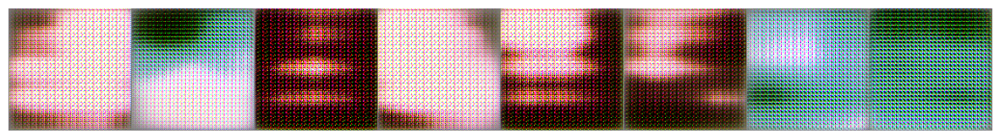

Epoch [    6/  100] | d_loss: -142.8461 | g_loss: 179.0981
Epoch [    7/  100] | d_loss: -187.4146 | g_loss: 7306.9917
Epoch [    8/  100] | d_loss: 147.7366 | g_loss: -148.1206
Epoch [    9/  100] | d_loss: 154.4050 | g_loss: 22.5038
Epoch [   10/  100] | d_loss: 84.3853 | g_loss: -345.9399


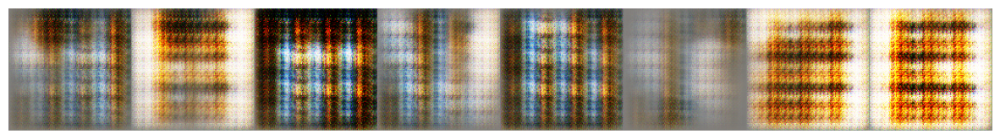

Epoch [   11/  100] | d_loss: 40.4126 | g_loss: -290.1038
Epoch [   12/  100] | d_loss: 6.0241 | g_loss: 76.0695
Epoch [   13/  100] | d_loss: 3.1407 | g_loss: 28.3183
Epoch [   14/  100] | d_loss: 8.8866 | g_loss: -2.5199
Epoch [   15/  100] | d_loss: 1.0450 | g_loss: -34.9765


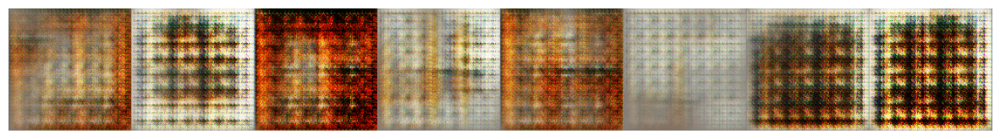

Epoch [   16/  100] | d_loss: -0.1108 | g_loss: 4.3891
Epoch [   17/  100] | d_loss: 0.9511 | g_loss: -6.5971
Epoch [   18/  100] | d_loss: 0.6062 | g_loss: 2.1366
Epoch [   19/  100] | d_loss: 0.0852 | g_loss: -19.0249
Epoch [   20/  100] | d_loss: 1.0586 | g_loss: -17.1338


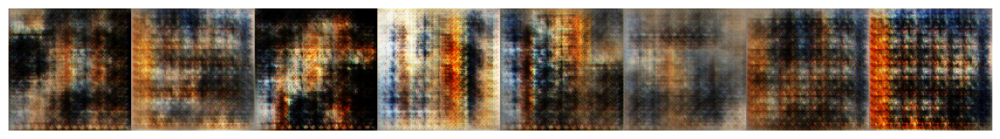

Epoch [   21/  100] | d_loss: 0.3068 | g_loss: 2.1691
Epoch [   22/  100] | d_loss: 0.3176 | g_loss: -6.3584
Epoch [   23/  100] | d_loss: -1.6792 | g_loss: -1.1528
Epoch [   24/  100] | d_loss: 0.2621 | g_loss: 5.4327
Epoch [   25/  100] | d_loss: 0.6593 | g_loss: -1.5007


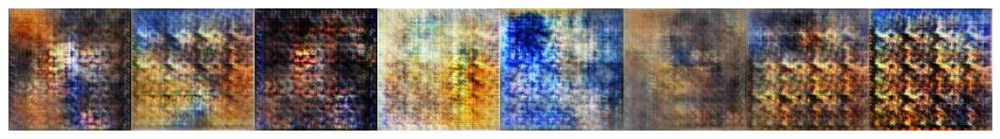

Epoch [   26/  100] | d_loss: 1.7754 | g_loss: -0.8325
Epoch [   27/  100] | d_loss: -1.1848 | g_loss: 4.4003
Epoch [   28/  100] | d_loss: -0.8275 | g_loss: -4.3104
Epoch [   29/  100] | d_loss: 3.3651 | g_loss: 6.2305
Epoch [   30/  100] | d_loss: -0.0482 | g_loss: 0.4918


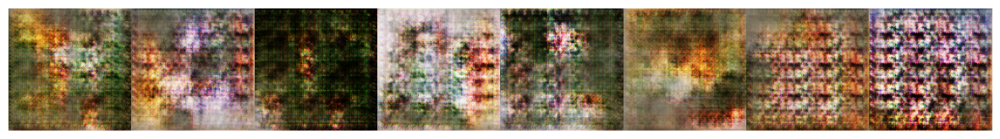

Epoch [   31/  100] | d_loss: 1.0706 | g_loss: -2.9911
Epoch [   32/  100] | d_loss: 0.3965 | g_loss: 0.0053
Epoch [   33/  100] | d_loss: 0.1651 | g_loss: -7.1051
Epoch [   34/  100] | d_loss: 0.0372 | g_loss: 0.5746
Epoch [   35/  100] | d_loss: -0.3476 | g_loss: -2.0914


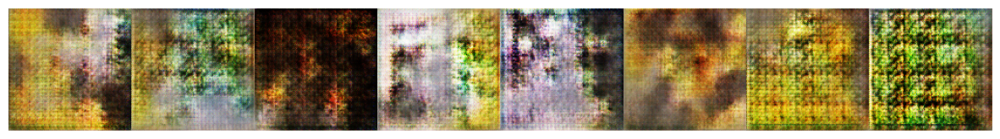

Epoch [   36/  100] | d_loss: -1.0709 | g_loss: -9.1873
Epoch [   37/  100] | d_loss: 2.8996 | g_loss: -0.8223
Epoch [   38/  100] | d_loss: 0.6796 | g_loss: -1.0695
Epoch [   39/  100] | d_loss: 0.2467 | g_loss: -0.2214
Epoch [   40/  100] | d_loss: 0.1540 | g_loss: 3.6189


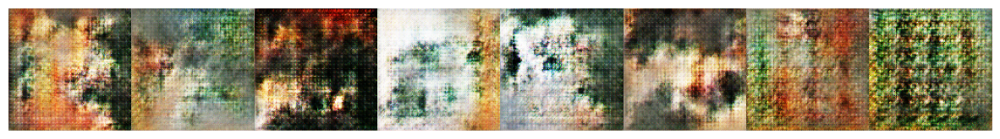

Epoch [   41/  100] | d_loss: -0.0856 | g_loss: 0.5695
Epoch [   42/  100] | d_loss: 0.3451 | g_loss: -1.5457
Epoch [   43/  100] | d_loss: 0.2315 | g_loss: -4.6503
Epoch [   44/  100] | d_loss: -0.5836 | g_loss: -6.0798
Epoch [   45/  100] | d_loss: 1.1626 | g_loss: 0.0346


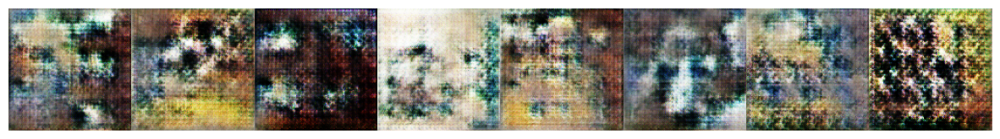

Epoch [   46/  100] | d_loss: -0.5023 | g_loss: 1.4820
Epoch [   47/  100] | d_loss: 2.2713 | g_loss: -1.0798
Epoch [   48/  100] | d_loss: -0.1702 | g_loss: -0.2343
Epoch [   49/  100] | d_loss: -0.5616 | g_loss: -3.1981
Epoch [   50/  100] | d_loss: -0.1993 | g_loss: 2.5849


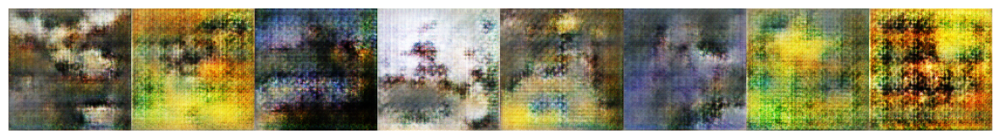

Epoch [   51/  100] | d_loss: -0.4567 | g_loss: -2.1445
Epoch [   52/  100] | d_loss: -0.9517 | g_loss: -0.8334
Epoch [   53/  100] | d_loss: 0.3239 | g_loss: 1.4445
Epoch [   54/  100] | d_loss: 2.4442 | g_loss: 2.7519
Epoch [   55/  100] | d_loss: -0.6506 | g_loss: 1.1769


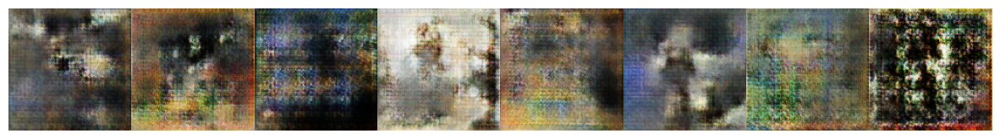

Epoch [   56/  100] | d_loss: 1.2631 | g_loss: 5.6291
Epoch [   57/  100] | d_loss: 0.4758 | g_loss: 0.4119
Epoch [   58/  100] | d_loss: -0.1988 | g_loss: 2.7565
Epoch [   59/  100] | d_loss: -0.8648 | g_loss: 8.3149
Epoch [   60/  100] | d_loss: -1.0809 | g_loss: -2.1684


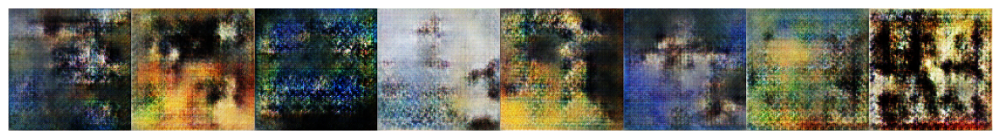

Epoch [   61/  100] | d_loss: -1.7380 | g_loss: -2.4977
Epoch [   62/  100] | d_loss: -1.0732 | g_loss: -0.5077
Epoch [   63/  100] | d_loss: 0.7958 | g_loss: -5.4715
Epoch [   64/  100] | d_loss: -1.3705 | g_loss: 10.3713
Epoch [   65/  100] | d_loss: 5.0587 | g_loss: 13.3590


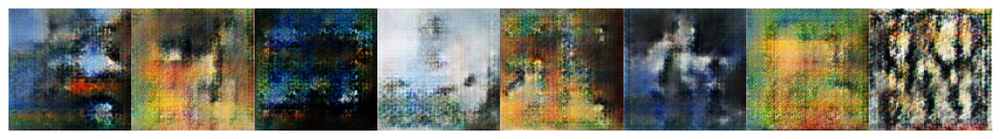

Epoch [   66/  100] | d_loss: -2.4276 | g_loss: -4.4247
Epoch [   67/  100] | d_loss: 1.0060 | g_loss: 8.9461
Epoch [   68/  100] | d_loss: -0.3160 | g_loss: 16.3054
Epoch [   69/  100] | d_loss: -3.2497 | g_loss: -8.0047
Epoch [   70/  100] | d_loss: -3.4343 | g_loss: -2.6361


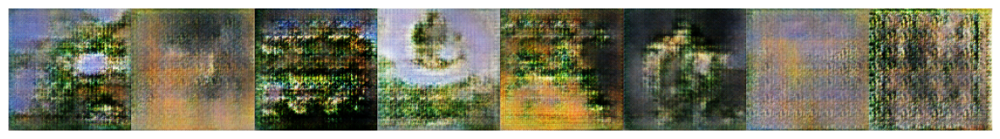

Epoch [   71/  100] | d_loss: -0.9957 | g_loss: 8.5680
Epoch [   72/  100] | d_loss: -0.3659 | g_loss: 8.9675
Epoch [   73/  100] | d_loss: 7.3750 | g_loss: 0.4815
Epoch [   74/  100] | d_loss: 4.1346 | g_loss: 20.5116
Epoch [   75/  100] | d_loss: 0.9605 | g_loss: 13.2326


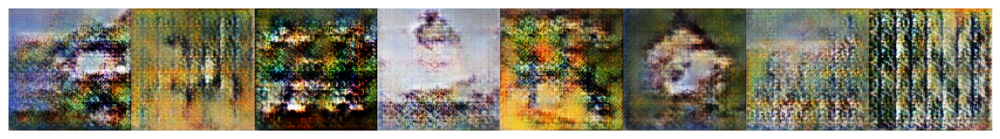

Epoch [   76/  100] | d_loss: 14.7134 | g_loss: 43.6809
Epoch [   77/  100] | d_loss: -2.8260 | g_loss: 11.3361
Epoch [   78/  100] | d_loss: -17.3360 | g_loss: 0.2263
Epoch [   79/  100] | d_loss: -1.0031 | g_loss: 23.2614
Epoch [   80/  100] | d_loss: -5.3848 | g_loss: 1.7076


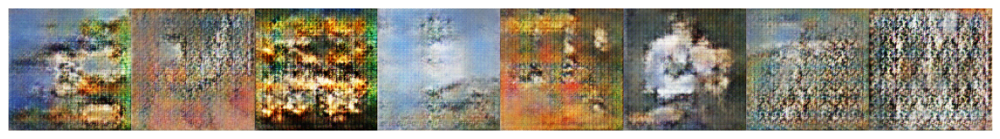

Epoch [   81/  100] | d_loss: -1.5930 | g_loss: -20.5108
Epoch [   82/  100] | d_loss: -1.9652 | g_loss: -12.6182
Epoch [   83/  100] | d_loss: -1.6951 | g_loss: -37.8707
Epoch [   84/  100] | d_loss: -11.8659 | g_loss: 49.9413
Epoch [   85/  100] | d_loss: -15.2518 | g_loss: 22.8540


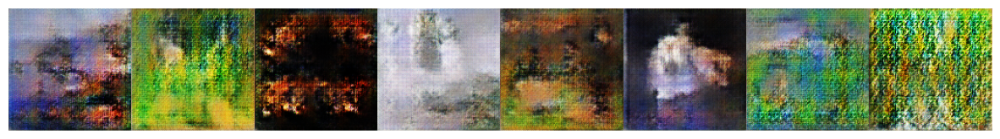

Epoch [   86/  100] | d_loss: -13.3575 | g_loss: 27.3788
Epoch [   87/  100] | d_loss: -0.8272 | g_loss: -1.1000
Epoch [   88/  100] | d_loss: -23.0291 | g_loss: 60.4717
Epoch [   89/  100] | d_loss: -8.5759 | g_loss: 57.5719
Epoch [   90/  100] | d_loss: -3.6075 | g_loss: 45.3207


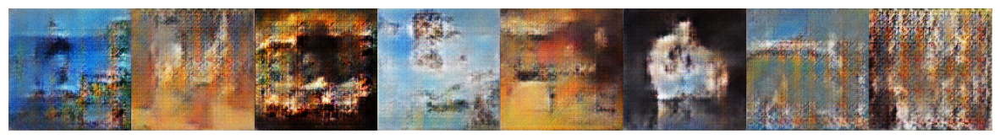

Epoch [   91/  100] | d_loss: 4.1586 | g_loss: 2.7158
Epoch [   92/  100] | d_loss: -17.4157 | g_loss: 50.0237
Epoch [   93/  100] | d_loss: -9.7324 | g_loss: 58.7732
Epoch [   94/  100] | d_loss: 5.8569 | g_loss: 30.3067
Epoch [   95/  100] | d_loss: 20.0236 | g_loss: 37.1916


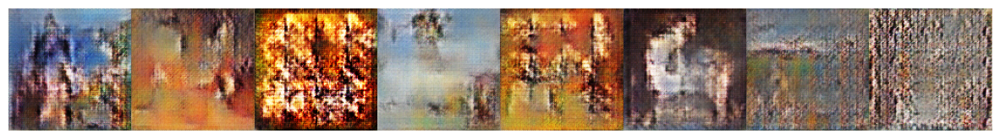

In [ ]:
import tensorflow as tf

# Hyperparameters
device = "GPU" if tf.config.list_physical_devices('GPU') else "CPU"
print("Device is", device)

z_dim = 150
beta_1 = 0.5
beta_2 = 0.999

n_epochs = 150
lr = 0.0002
lr_g = 0.0004
batch_size = 128
image_size = 128

EPOCHS = 100
train(disc, gen, 
      EPOCHS, dataloader, 
      d_optimizer, g_optimizer, 
      z_dim, 
      print_every=5)



Usage limits in colab, but I reckon things can get better this WGAN and gradient penalties

In [ ]:
def print_tensor_images(images_tensor):
    plt.rcParams['figure.figsize'] = (15, 15)
    plt.subplots_adjust(wspace=0, hspace=0)
    
    npimgs = images_tensor.numpy()
    
    no_plots = len(npimgs)

    for idx, image in enumerate(npimgs):
        plt.subplot(1, 8, idx+1)
        plt.axis('off')
        # dnorm
        image = image * 0.5 + 0.5
        plt.imshow(image)  # Removed np.transpose
    plt.show()

progan


In [ ]:
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras import Sequential
from tensorflow.keras.layers import InputLayer, Conv2D, LeakyReLU
from tensorflow.keras.layers import Dense


class ProGANGenerator(tf.keras.Model):
    def __init__(self, z_dim=100, in_chan=3, hidden_dim=64):

        super(ProGANGenerator, self).__init__()

        self.upsample = tf.keras.layers.UpSampling2D()
        
        self.z_dim = z_dim
        self.in_chan = in_chan
        self.hidden_dim = hidden_dim

        self.initial_layer = tf.keras.Sequential([
            tf.keras.layers.Dense(4 * 4 * hidden_dim * 8, use_bias=False, input_shape=(z_dim,)),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
            tf.keras.layers.Reshape((4, 4, hidden_dim * 8)),
        ])


        self.progress_blocks = [
            self.make_gen_block(hidden_dim * 8, hidden_dim * 8),
            self.make_gen_block(hidden_dim * 8, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, hidden_dim // 2),
            self.make_gen_block(hidden_dim // 2, hidden_dim // 4),
            self.make_gen_block(hidden_dim // 4, hidden_dim // 8),
            self.make_gen_block(hidden_dim // 8, hidden_dim // 16),
        ]


        self.to_rgb = tf.keras.Sequential([
            tf.keras.layers.Conv2D(in_chan, (1, 1), padding='same', use_bias=False, activation='tanh')
        ])

    def make_gen_block(self, in_channels, out_channels):
        return tf.keras.Sequential([
            tf.keras.layers.UpSampling2D(),
            tf.keras.layers.Conv2D(out_channels, (3, 3), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
            tf.keras.layers.Conv2D(out_channels, (3, 3), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
        ])

    def call(self, noise, alpha, phase):
        x = self.initial_layer(noise)

        for i, block in enumerate(self.progress_blocks):
            if i == phase:
                break

            y = block(x)
            x = y
        if phase > 0:
            x_prev = self.progress_blocks[phase - 1](x)
            x_prev = self.to_rgb(x_prev)

            x = self.to_rgb(y)

            print("x_prev shape:", x_prev.shape)
            print("x shape:", x.shape)

            x = alpha * x + (1 - alpha) * x_prev
        else:
            x = self.to_rgb(x)


        return x

class MinibatchStdev(layers.Layer):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)

    def call(self, x):
        batch_size, height, width, channels = x.shape.as_list()

        # Calculate the standard deviation
        std = tf.math.reduce_std(x, axis=0, keepdims=True)

        # Take the average of the standard deviation over all channels
        mean_std = tf.reduce_mean(std, axis=[1, 2, 3], keepdims=True)

        # Create a tensor of shape (batch_size, height, width, 1) by repeating the mean_std over the batch dimension
        repeated_mean_std = tf.tile(mean_std, [batch_size, height, width, 1])

        # Concatenate the repeated mean_std with the input tensor along the channel dimension
        x = tf.concat([x, repeated_mean_std], axis=-1)

        return x





from tensorflow_addons.layers import SpectralNormalization

class Discriminator(tf.keras.Model):
    def __init__(self, initial_filters=64):
        super(Discriminator, self).__init__()

        self.initial_filters = initial_filters

        self.from_rgb = [
            tf.keras.Sequential([
                tf.keras.layers.Conv2D(initial_filters // 4, (1, 1), padding='same', use_bias=False, input_shape=(None, None, 3)),
                tf.keras.layers.LeakyReLU(),
            ]),
            tf.keras.Sequential([
                tf.keras.layers.Conv2D(initial_filters // 2, (1, 1), padding='same', use_bias=False, input_shape=(None, None, 3)),
                tf.keras.layers.LeakyReLU(),
            ]),
            tf.keras.Sequential([
                tf.keras.layers.Conv2D(initial_filters, (1, 1), padding='same', use_bias=False, input_shape=(None, None, 3)),
                tf.keras.layers.LeakyReLU(),
            ]),
            tf.keras.Sequential([
                tf.keras.layers.Conv2D(initial_filters * 2, (1, 1), padding='same', use_bias=False),
                tf.keras.layers.LeakyReLU()
            ]),
            tf.keras.Sequential([
                tf.keras.layers.Conv2D(initial_filters * 4, (1, 1), padding='same', use_bias=False),
                tf.keras.layers.LeakyReLU()
            ]),
            # Add more layers as needed to match the number of phases
        ]

        self.progress_blocks = [
            self.make_disc_block(initial_filters // 4, initial_filters // 2),
            self.make_disc_block(initial_filters // 2, initial_filters),
            self.make_disc_block(initial_filters, initial_filters * 2),
            self.make_disc_block(initial_filters * 2, initial_filters * 4),
            self.make_disc_block(initial_filters * 4, initial_filters * 8),
            self.make_disc_block(initial_filters * 8, initial_filters * 8),
            # Add more blocks as needed to increase resolution
        ]

        self.final_block = tf.keras.Sequential([
            tf.keras.layers.Flatten(),
            tf.keras.layers.Dense(1)
        ])

    def make_disc_block(self, in_channels, out_channels):
        return tf.keras.Sequential([
            tf.keras.layers.Conv2D(out_channels, (3, 3), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
            tf.keras.layers.Conv2D(out_channels, (3, 3), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
            tf.keras.layers.AveragePooling2D()
        ])

    def call(self, images, alpha, phase):
        if phase == 0:
            x = self.from_rgb[phase](images)
            x = self.progress_blocks[phase](x)
        else:
            x_prev = self.from_rgb[phase - 1](images)
            x_prev = self.progress_blocks[phase](x_prev)  # Fix: Use phase instead of phase - 1

            x = self.from_rgb[phase](images)
            x = self.progress_blocks[phase](x)

            x = alpha * x + (1 - alpha) * x_prev

        for i in range(phase + 1, len(self.progress_blocks)):
            x = self.progress_blocks[i](x)

        x = self.final_block(x)
        return x



In [ ]:
def wasserstein_loss(y_true, y_pred):
    return tf.reduce_mean(y_true * y_pred)

def real_loss(D_out):
    return wasserstein_loss(tf.ones_like(D_out), D_out)

def fake_loss(D_out):
    return wasserstein_loss(-tf.ones_like(D_out), D_out)

    
def gradient_penalty(real_images, fake_images, discriminator):
    epsilon = tf.random.uniform([real_images.shape[0], 1, 1, 1], 0, 1)
    interpolates = epsilon * real_images + (1 - epsilon) * fake_images
    with tf.GradientTape() as tape:
        tape.watch(interpolates)
        disc_interpolates = discriminator(interpolates)
    gradients = tape.gradient(disc_interpolates, [interpolates])[0]
    gradients_sqr = tf.square(gradients)
    gradients_sqr_sum = tf.reduce_sum(gradients_sqr, axis=np.arange(1, len(gradients_sqr.shape)))
    gradient_penalty = tf.reduce_mean((gradients_sqr_sum - 1) ** 2)
    return gradient_penalty
def train(D, G, n_epochs, dataloader, d_optimizer, g_optimizer, z_dim, alpha, phase, print_every=50, gp=10):
    ## Get some fixed data for sampling.##      
    sample_size = 8
    fixed_z = get_noise(n_samples=sample_size, z_dim=z_dim)

    for epoch in range(1, n_epochs+1):

        for batch_i, (real_images, _) in enumerate(dataloader):

            batch_size = real_images.shape[0]

            ### Discriminator part ###
            with tf.GradientTape() as tape:
                # Loss on real image
                print(real_images, alpha, phase)
                d_real_op = D(real_images, alpha, phase)
                print('pass')
                d_real_loss = real_loss(d_real_op)

                # Loss on fake image
                noise = get_noise(n_samples=batch_size, z_dim=z_dim)
                fake_images = G(noise, alpha, phase)
                d_fake_op = D(fake_images, alpha, phase)
                d_fake_loss = fake_loss(d_fake_op)

                # Total loss
                d_loss = d_real_loss + d_fake_loss

            gradients = tape.gradient(d_loss, D.trainable_variables)
            d_optimizer.apply_gradients(zip(gradients, D.trainable_variables))

            # Gradient penalty computation
            gradient_penalty = gradient_penalty(real_images, fake_images, D)
            d_loss += gp * gradient_penalty
            gradients = tape.gradient(d_loss, D.trainable_variables)
            d_optimizer.apply_gradients(zip(gradients, D.trainable_variables))

            ### Generator part ###
            with tf.GradientTape() as tape:
                noise = get_noise(n_samples=batch_size, z_dim=z_dim)
                g_out = G(noise, alpha, phase)
                d_out = D(g_out, alpha, phase)
                
                g_loss = real_loss(d_out)

            gradients = tape.gradient(g_loss, G.trainable_variables)
            g_optimizer.apply_gradients(zip(gradients, G.trainable_variables))
        
        print('Epoch [{:5d}/{:5d}] | d_loss: {:6.4f} | g_loss: {:6.4f}'.format(
                                epoch, n_epochs, d_loss.numpy(), g_loss.numpy()))
        if (epoch % print_every == 0):
            G.trainable = False
            sample_image = G(fixed_z, alpha, phase)
            print_tensor_images(sample_image)
            G.trainable = True


# Model initialization
image_size = 4
gen = ProGANGenerator(z_dim=100, in_chan=3, hidden_dim=64)
initial_filters = 64
z_dim = 100
disc = Discriminator(initial_filters = 64)



# Optimizer initialization
g_optimizer = tf.keras.optimizers.Adam(learning_rate=0.001, beta_1=0, beta_2=0.99)
d_optimizer = tf.keras.optimizers.Adam(learning_rate=0.001, beta_1=0, beta_2=0.99)


train_dataset = get_dataloader_tf(batch_size, image_size, image_root)


pass
Found 8683 files belonging to 1 classes.


In [ ]:
disc

In [ ]:
image_size

128

In [ ]:
train_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 128, 128, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

In [ ]:
# Training hyperparameters
n_epochs = 55
z_dim = 100
alpha = 0.5
phase = 1  # Set this according to the desired resolution

# Train the model
train(disc, gen, n_epochs, train_dataset, d_optimizer, g_optimizer, z_dim, alpha, phase, print_every=5, gp=10)


ValueError: ignored